In [1]:
from visual_behavior import utilities as vbu
import visual_behavior.plotting as vbp
from visual_behavior.utilities import EyeTrackingData
from visual_behavior import database as db
import pandas as pd
import matplotlib.pyplot as plt
import os
import numpy as np
import time
import seaborn as sns
import matplotlib.patches as patches

from scipy import stats

from multiprocessing import Pool

from dro.modules import eye_tracking as et
from dro.modules import plotting as plot_utils

In [2]:
%matplotlib notebook
%widescreen

In [3]:
save_figures = True
figure_savefolder = '/allen/programs/braintv/workgroups/nc-ophys/visual_behavior/eye_tracking_figures/figures_for_analysis_paper'

In [4]:
manifest = pd.read_csv('/allen/programs/braintv/workgroups/nc-ophys/Doug/2019.12.10.sessions_with_tracking.csv')
sessions_to_exclude = pd.read_csv('/allen/programs/braintv/workgroups/nc-ophys/visual_behavior/2019.12.10_eye_tracking_sessions_to_exclude.csv')
manifest = manifest[~manifest['ophys_session_id'].isin(sessions_to_exclude['sessions_to_exclude'].tolist())]

additional_sessions_to_exclude = [
    960475393, #mislabeled session name
]
manifest = manifest[~manifest['ophys_session_id'].isin(additional_sessions_to_exclude)]

In [5]:
eye_dict = {}
pool = Pool(16)
osids = manifest['ophys_session_id'].unique()
ans = pool.map(et.open_eye_data,osids)
eye_dict = {d.ophys_session_id:d for d in ans if d is not None}

opening eye data for osid = 955991376
opening eye data for osid = 959454463
opening eye data for osid = 942114744
opening eye data for osid = 938359348
opening eye data for osid = 940775208
opening eye data for osid = 932664150
opening eye data for osid = 948042811
opening eye data for osid = 961226856
opening eye data for osid = 935859569
opening eye data for osid = 925478114
opening eye data for osid = 931687751
opening eye data for osid = 954961790
opening eye data for osid = 921922878
opening eye data for osid = 922743776
opening eye data for osid = 929255931
opening eye data for osid = 928142719
opening eye data for osid = 920317769
opening eye data for osid = 958931715
opening eye data for osid = 923704003
opening eye data for osid = 960593969
opening eye data for osid = 929688369
opening eye data for osid = 947199653
opening eye data for osid = 952434025
opening eye data for osid = 935559843
opening eye data for osid = 954981981
opening eye data for osid = 939524851
opening eye 

/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



opening eye data for osid = 855333357
opening eye data for osid = 841303580
opening eye data for osid = 839208243
opening eye data for osid = 849600749
opening eye data for osid = 833002992
opening eye data for osid = 835796136
opening eye data for osid = 825682242
opening eye data for osid = 846599329
opening eye data for osid = 809393834
opening eye data for osid = 811234448
opening eye data for osid = 808340530
opening eye data for osid = 819949602
opening eye data for osid = 807393193
opening eye data for osid = 806812738
opening eye data for osid = 848891498
opening eye data for osid = 805269503
opening eye data for osid = 848264175


/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



opening eye data for osid = 799195371
opening eye data for osid = 842583486
opening eye data for osid = 798007990
opening eye data for osid = 794706889
opening eye data for osid = 809261351
opening eye data for osid = 775289198
opening eye data for osid = 808092249
opening eye data for osid = 807208045
opening eye data for osid = 806203732
opening eye data for osid = 804929369
opening eye data for osid = 797078933
opening eye data for osid = 799021448
opening eye data for osid = 794082263
opening eye data for osid = 808387448
opening eye data for osid = 807055274
opening eye data for osid = 807667681


/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



opening eye data for osid = 803223329
opening eye data for osid = 805643175
opening eye data for osid = 795217244
opening eye data for osid = 789220000
opening eye data for osid = 798818118


In [6]:
pool = Pool(16)
bd = pool.map(et.open_behavior_data,list(eye_dict.keys()))
behavior_dict = {d.ophys_session_id:d for d in bd if d is not None}

opening behavior data for osid = 959454463
opening behavior data for osid = 928142719
opening behavior data for osid = 948042811
opening behavior data for osid = 940775208
opening behavior data for osid = 929255931
opening behavior data for osid = 942114744
opening behavior data for osid = 922743776
opening behavior data for osid = 938359348
opening behavior data for osid = 961226856
opening behavior data for osid = 935859569
opening behavior data for osid = 931687751
opening behavior data for osid = 955991376
opening behavior data for osid = 932664150
opening behavior data for osid = 925478114
opening behavior data for osid = 954961790
opening behavior data for osid = 921922878
opening behavior data for osid = 947199653
opening behavior data for osid = 923704003
opening behavior data for osid = 939524851
opening behavior data for osid = 935559843
opening behavior data for osid = 920317769
opening behavior data for osid = 929688369
opening behavior data for osid = 922511481
opening beh

In [7]:
with Pool(16) as pool:
    rd = pool.map(et.get_response_data,np.sort(list(behavior_dict.keys())))
response_dict = {d['ophys_session_id']:d for d in rd if d is not None}

opening eye data for osid = 775289198
opening eye data for osid = 815485890
opening eye data for osid = 794706889
opening eye data for osid = 805269503
opening eye data for osid = 830272668
opening eye data for osid = 798007990
opening eye data for osid = 809393834
opening eye data for osid = 799195371
opening eye data for osid = 835795999
opening eye data for osid = 807393193
opening eye data for osid = 842364341
opening eye data for osid = 808340530
opening eye data for osid = 840490733
opening eye data for osid = 837363020
opening eye data for osid = 806812738
opening eye data for osid = 824745199
opening behavior data for osid = 840490733
opening behavior data for osid = 842364341
opening behavior data for osid = 806812738
opening behavior data for osid = 808340530
opening behavior data for osid = 807393193
opening behavior data for osid = 824745199
opening behavior data for osid = 809393834
opening behavior data for osid = 830272668
opening behavior data for osid = 799195371
openi

/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



done with osid = 775289198, that took 40.95502471923828 seconds
done with osid = 830272668, that took 40.98901867866516 seconds
opening eye data for osid = 789220000
opening eye data for osid = 833002992
done with osid = 837363020, that took 41.20457172393799 seconds
opening eye data for osid = 839208243
done with osid = 835795999, that took 41.30363321304321 seconds
opening eye data for osid = 835796136
done with osid = 799195371, that took 41.3392915725708 seconds
opening eye data for osid = 803223329
done with osid = 815485890, that took 41.526137590408325 seconds
opening eye data for osid = 819949602
done with osid = 798007990, that took 41.772228479385376 seconds
opening eye data for osid = 798818118
done with osid = 794706889, that took 41.842493772506714 seconds
opening eye data for osid = 795217244
opening behavior data for osid = 841303580
opening behavior data for osid = 807055274
opening behavior data for osid = 805643175
opening behavior data for osid = 811234448
opening be

/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



done with osid = 855083235, that took 45.224854707717896 seconds
opening eye data for osid = 855333357
opening behavior data for osid = 888940531
done with osid = 879897824, that took 44.60885238647461 seconds
opening eye data for osid = 880753403
done with osid = 860331718, that took 45.89813542366028 seconds
opening eye data for osid = 863527124
done with osid = 873542787, that took 45.591835021972656 seconds
opening eye data for osid = 876557230
opening behavior data for osid = 892217026
opening behavior data for osid = 907991198
opening behavior data for osid = 902777219
done with osid = 894204946, that took 46.18955636024475 seconds
opening eye data for osid = 898295293
opening behavior data for osid = 906521029
opening behavior data for osid = 910739829
opening behavior data for osid = 848264175
done with osid = 888940531, that took 27.464545011520386 seconds
opening eye data for osid = 889179793
opening behavior data for osid = 848891498
opening behavior data for osid = 84960074

/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



done with osid = 855333357, that took 27.202032566070557 seconds
opening eye data for osid = 855353286
opening behavior data for osid = 889179793
done with osid = 863527124, that took 28.3010733127594 seconds
opening eye data for osid = 863981645
opening behavior data for osid = 893937838
opening behavior data for osid = 880753403
opening behavior data for osid = 908441202
done with osid = 898295293, that took 27.970954179763794 seconds
opening eye data for osid = 900802327
opening behavior data for osid = 876557230
opening behavior data for osid = 906968227
done with osid = 846599329, that took 43.695472717285156 seconds
opening eye data for osid = 848143026
done with osid = 889179793, that took 27.51341938972473 seconds
opening eye data for osid = 913564409
done with osid = 893937838, that took 26.544928312301636 seconds
opening eye data for osid = 914639324
opening behavior data for osid = 854524023
done with osid = 880753403, that took 42.671658754348755 seconds
opening eye data fo

/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



done with osid = 914728054, that took 26.810806274414062 seconds
opening eye data for osid = 914797752
opening behavior data for osid = 913834848
opening behavior data for osid = 922743776
opening behavior data for osid = 928142719
done with osid = 919041767, that took 23.46178364753723 seconds
opening eye data for osid = 919432737
done with osid = 918718550, that took 28.669214010238647 seconds
opening eye data for osid = 918719819
opening behavior data for osid = 915587736
opening behavior data for osid = 931564063
opening behavior data for osid = 932664150
done with osid = 935859569, that took 26.885023832321167 seconds
opening eye data for osid = 937162622
done with osid = 913834848, that took 41.42935228347778 seconds
opening eye data for osid = 914161594
done with osid = 928142719, that took 40.59845280647278 seconds
opening eye data for osid = 928146339
opening behavior data for osid = 927721370
opening behavior data for osid = 929686773
done with osid = 922743776, that took 44.

/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:403: UserWarning:

no matching sync line for behavior



done with osid = 961226856, that took 24.61985969543457 seconds
opening behavior data for osid = 939526443
done with osid = 942114744, that took 37.84059143066406 seconds
opening eye data for osid = 943299247
opening behavior data for osid = 948090163
done with osid = 923704003, that took 21.804699897766113 seconds
opening behavior data for osid = 954961790
opening behavior data for osid = 959751299
opening behavior data for osid = 957189583
done with osid = 939526443, that took 25.859517812728882 seconds
done with osid = 948090163, that took 17.568258047103882 seconds
opening eye data for osid = 952434025
opening behavior data for osid = 941300832
done with osid = 954961790, that took 20.298180103302002 seconds
opening eye data for osid = 954981981
done with osid = 959751299, that took 20.011087656021118 seconds
opening eye data for osid = 960593969
done with osid = 957189583, that took 20.759355306625366 seconds
opening eye data for osid = 958931715
opening behavior data for osid = 9

## look at an example session in time

In [8]:
osid = 955991376 #manifest.sample(random_state=6)['ophys_session_id'].iloc[0]

bd = et.open_behavior_data(osid)
ed = et.open_eye_data(osid)

opening behavior data for osid = 955991376
opening eye data for osid = 955991376


<IPython.core.display.Javascript object>


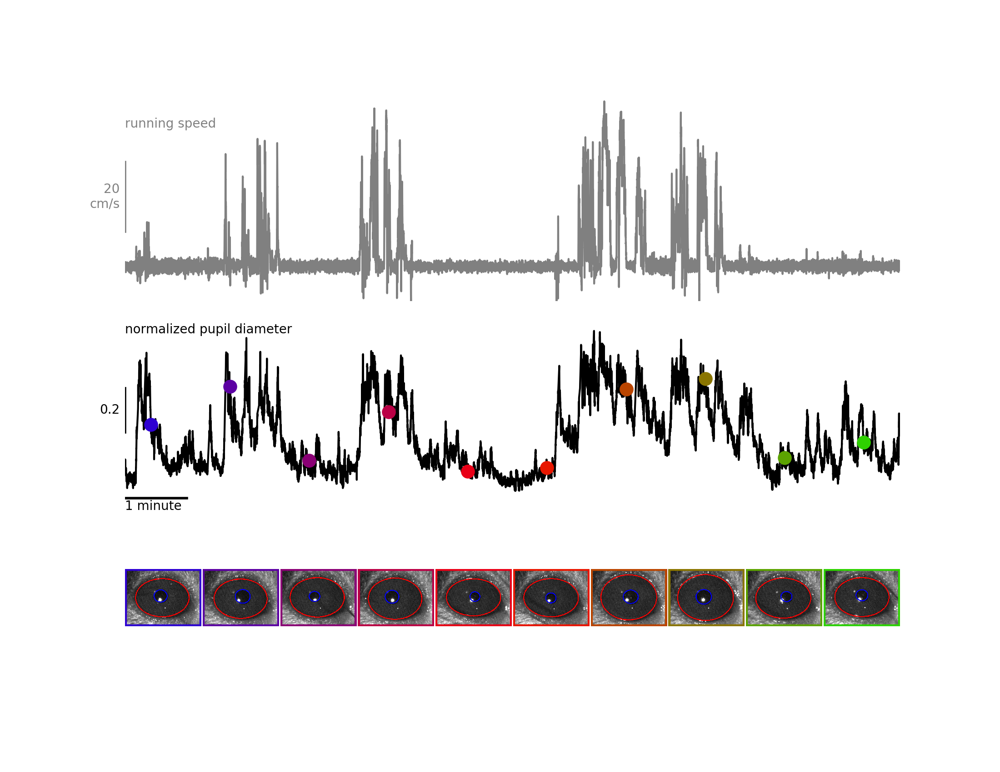

In [9]:
# fig,ax=plt.subplots(2,1,sharex=True,figsize=(12,6))
fig=plt.figure(figsize=(12,6))
ax = [
    vbp.placeAxesOnGrid(fig,xspan=(0,1),yspan=(0,0.35)),
    vbp.placeAxesOnGrid(fig,xspan=(0,1),yspan=(0.35,0.7))
]
N = 10
ax_frames = [vbp.placeAxesOnGrid(fig,xspan=(n*1/N,(n+1)*1/N),yspan=(0.7,1)) for n in range(10)]


ax[0].plot(
    bd.running['time'],
    bd.running['speed'],
    color='gray'
)

dfp = ed.ellipse_fits['pupil'].rename(columns={'t':'time'})
ax[1].plot(
    dfp['time'],
    dfp['normalized_blink_corrected_area'],
    color='black'
)

ax[0].set_ylabel('running_speed (cm/s)')
ax[1].set_ylabel('pupil diameter (pixels**2)')
ax[1].set_xlabel('session time')

for axis in ax:
    axis.axis('off')

ax[0].set_xlim(1300,2050)
ax[1].set_xlim(1300,2050)

plt.subplots_adjust(hspace=-0.1)

ax[0].set_ylim(-10,50)
ax[1].set_ylim(0.15,1.1)

ax[0].text(1300,40,'running speed',color='gray')
ax[1].text(1300,0.95,'normalized pupil diameter',color='black')

ax[1].plot([1300,1360],[0.2,0.2],linewidth=2,color='black')
ax[1].text(1300,0.19,'1 minute',va='top')


ax[1].plot([1300,1300],[0.5,0.7],linewidth=2,color='black')
ax[1].text(1295,0.6,'0.2',va='center',ha='right')

ax[0].plot([1300,1300],[10,30],linewidth=2,color='gray')
ax[0].text(1295,20,'20\ncm/s',va='center',ha='right',color='gray')

palette = sns.color_palette("brg", 10)
for ii,t in enumerate(np.linspace(1325,2015,10)):
    rect = patches.Rectangle((0,0),399,299,linewidth=3,edgecolor=palette[ii],facecolor='none')
    
    ax_frames[ii].imshow(ed.get_annotated_frame(time=t)[125:425,100:500])
    ax_frames[ii].axis('off')
    ax_frames[ii].add_patch(rect)
    
    idx = np.abs(dfp['time'] - t).argmin()
    ax[1].plot(
        dfp.loc[idx]['time'],
        dfp.loc[idx]['normalized_blink_corrected_area'],
        marker='o',
        markersize=10,
        color=palette[ii],
    )
    
fig_title = 'data_sample'
if save_figures:
    vbp.save_figure(fig,os.path.join(figure_savefolder,fig_title),formats=['.pdf','.png'])

## get averages around the omission

In [10]:
df_omitted_means = pd.DataFrame()

for ids,session in manifest.iterrows():
    df = response_dict[session['ophys_session_id']]['pupil_area']['omitted_stim']
    
    if 't' in df.columns:
        time_parameter = 't'
    elif 'time' in df.columns:
        time_parameter = 'time'
        
    cols = [col for col in df.columns if col != time_parameter]
    mean_response = et.convert_to_fraction(df)[cols].mean(axis=1)
    
    if len(df_omitted_means) == 0:
        df_omitted_means['time'] = df[time_parameter]
    
    df_omitted_means[session['ophys_session_id']] = mean_response


<IPython.core.display.Javascript object>


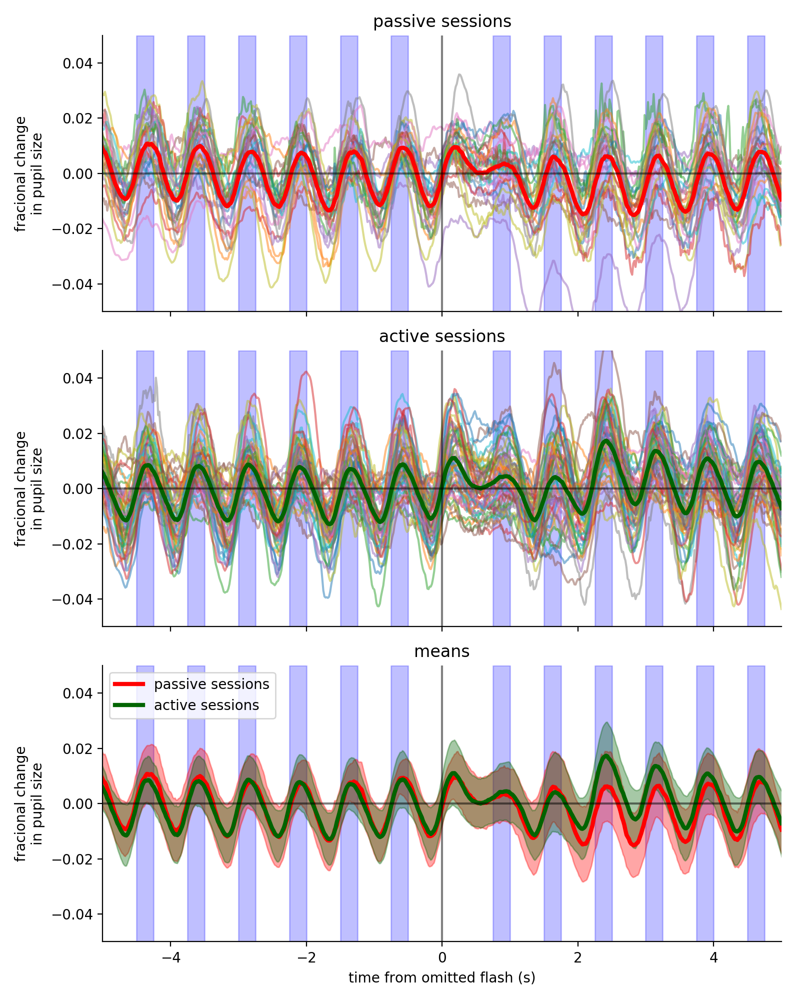

In [11]:
passive_sessions = manifest[(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]
active_sessions = manifest[(~manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]

fig,ax=plt.subplots(3,1,figsize=(8,10),sharex=True,sharey=True)
for osid in passive_sessions['ophys_session_id'].unique():
    ax[0].plot(df_omitted_means['time'],df_omitted_means[osid],alpha=0.5)
for osid in active_sessions['ophys_session_id'].unique():
    ax[1].plot(df_omitted_means['time'],df_omitted_means[osid],alpha=0.5)
    
for ii in [0,2]:
    ax[ii].plot(df_omitted_means['time'],df_omitted_means[passive_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='red')
for ii in [1,2]:
    ax[ii].plot(df_omitted_means['time'],df_omitted_means[active_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='darkgreen')

for sessions,color in zip([passive_sessions,active_sessions],['red','darkgreen']):
    cols = sessions['ophys_session_id'].unique()
    ax[2].fill_between(
        df_omitted_means['time'], 
        df_omitted_means[cols].mean(axis=1) + df_omitted_means[cols].std(axis=1), 
        df_omitted_means[cols].mean(axis=1) - df_omitted_means[cols].std(axis=1), 
        color=color, 
        alpha=0.35
    )
    
ax[0].set_title('passive sessions')
ax[1].set_title('active sessions')
ax[2].set_title('means')
ax[2].legend(['passive sessions','active sessions'])

ax[0].set_xlim(-5,5)
ax[0].set_ylim(-.05,.05)
for ii in range(3):
    ax[ii].axvline(0,color='black',alpha=0.5)
    ax[ii].axhline(0,color='black',alpha=0.5)
    et.designate_flashes(ax[ii],omit=0)
    ax[ii].set_ylabel("fracional change\nin pupil size")
ax[2].set_xlabel('time from omitted flash (s)')

sns.despine()
fig.tight_layout()


<IPython.core.display.Javascript object>


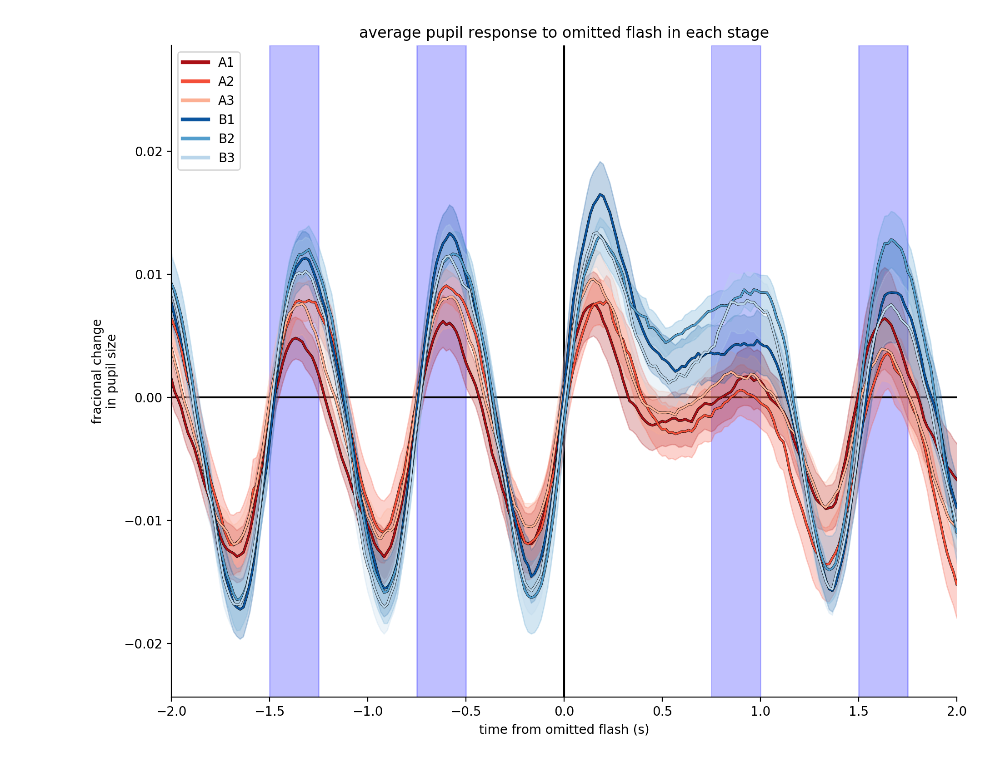

In [12]:
fig,ax=plt.subplots(figsize=(6,6))
stage_names = np.sort(manifest[manifest['project_code']=='VisualBehavior']['stage_name'].unique())
                        
plot_utils.initialize_legend(ax,[et.get_session_color(et.get_session_name(stage_name)) for stage_name in stage_names],linewidth=3)

for stage_name in stage_names:

    sessions = manifest.query('stage_name == @stage_name')
    session_name = et.get_session_name(stage_name)
    cols = sessions['ophys_session_id'].unique()
    for lt,color in zip([2,1.5],['black',et.get_session_color(session_name)]):
        ax.plot(
            df_omitted_means['time'],
            df_omitted_means[cols].mean(axis=1),
            alpha=1,
            linewidth=lt,
            color=color
        )
    ax.fill_between(
        df_omitted_means['time'], 
        df_omitted_means[cols].mean(axis=1) + df_omitted_means[cols].std(axis=1)/np.sqrt(len(cols)), 
        df_omitted_means[cols].mean(axis=1) - df_omitted_means[cols].std(axis=1)/np.sqrt(len(cols)), 
        color=et.get_session_color(session_name), 
        alpha=0.25
    )
ax.set_xlim(-2,2)
    
ax.legend([et.get_session_name(stage_name) for stage_name in stage_names])

sns.despine()

ax.set_title('average pupil response to omitted flash in each stage')
ax.set_ylabel("fracional change\nin pupil size")
ax.set_xlabel('time from omitted flash (s)')

ax.axvline(0,color='k',zorder=-np.inf)
ax.axhline(0,color='k',zorder=-np.inf)

et.designate_flashes(ax,omit=0)
fig.tight_layout()

fig_title = 'omitted_flash_response'
if save_figures:
    vbp.save_figure(fig,os.path.join(figure_savefolder,fig_title),formats=['.pdf','.png'])

<IPython.core.display.Javascript object>


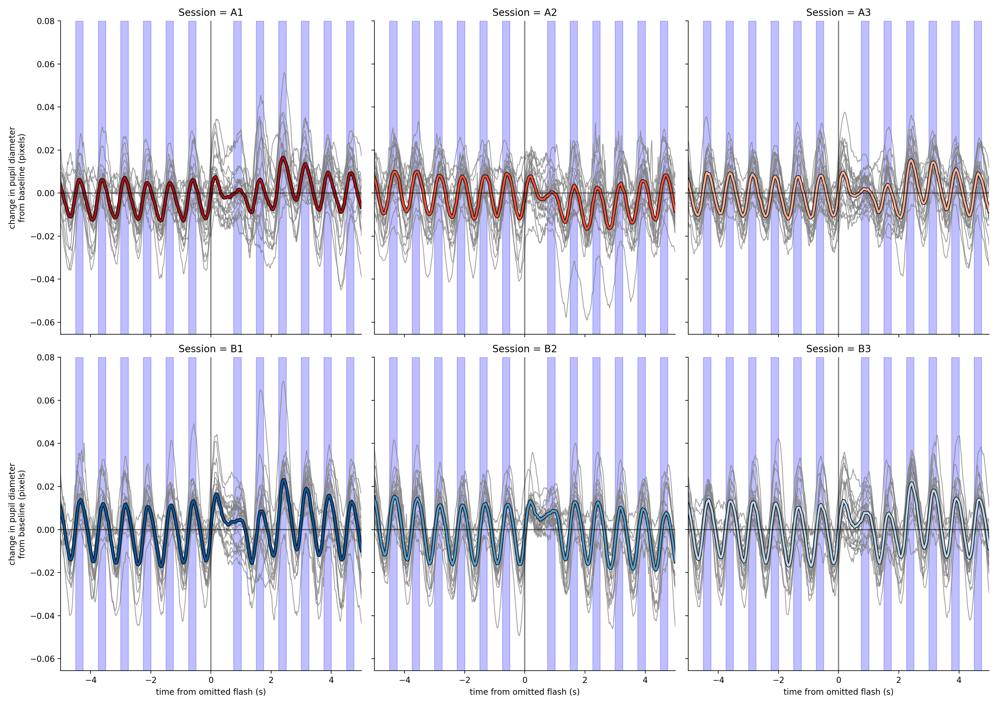

In [13]:
fig,axes=plt.subplots(2,3,sharex=True,sharey=True,figsize=(17,12))
for ii,ax in enumerate(axes.flatten()):
    stage_name = stage_names[ii]
    sessions = manifest.query('stage_name == @stage_name')
    session_name = et.get_session_name(stage_name)
    cols = sessions['ophys_session_id'].unique()
    
    for col in cols:
        ax.plot(
            df_omitted_means['time'],
            df_omitted_means[col],
            alpha=0.75,
            linewidth=1,
            color='gray', #et.get_session_color(session_name)
        )
    
    for lt,color in zip([4,2.5],['black',et.get_session_color(session_name)]):
        ax.plot(
            df_omitted_means['time'],
            df_omitted_means[cols].mean(axis=1),
            alpha=1,
            linewidth=lt,
            color=color
        )
    ax.set_title('Session = {}'.format(session_name))
    
    ax.axvline(0,color='black',alpha=0.5)
    ax.axhline(0,color='black',alpha=0.5)
    
    ax.set_xlim(-5,5)
    et.designate_flashes(ax,omit=0)

for ii in [0,3]:
    axes.flatten()[ii].set_ylabel("change in pupil diameter\nfrom baseline (pixels)")
for ii in [3,4,5]:
    axes.flatten()[ii].set_xlabel('time from omitted flash (s)')
    
fig.tight_layout()
sns.despine()

## hit and CR trials?

In [14]:
df_hit = pd.DataFrame()
df_cr = pd.DataFrame()

for ids,session in manifest.iterrows():
    dfh = response_dict[session['ophys_session_id']]['pupil_area']['hit']
    dfcr = response_dict[session['ophys_session_id']]['pupil_area']['cr']
    
    if 't' in df.columns:
        time_parameter = 't'
    elif 'time' in df.columns:
        time_parameter = 'time'
        
    cols_h = [col for col in dfh.columns if col != time_parameter]
    mean_response_hit = et.convert_to_fraction(dfh)[cols_h].mean(axis=1)
    cols_cr = [col for col in dfcr.columns if col != time_parameter]
    mean_response_cr = et.convert_to_fraction(dfcr)[cols_cr].mean(axis=1)
    
    if len(df_hit) == 0:
        df_hit['time'] = dfh[time_parameter]
        df_cr['time'] = dfcr[time_parameter]
    
    df_hit[session['ophys_session_id']] = mean_response_hit
    df_cr[session['ophys_session_id']] = mean_response_cr

In [15]:
active_sessions = manifest[~(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]
active_sessions

,index,_id,container_id,container_workflow_state,date_of_acquisition,donor_id,driver_line,entry_time_utc,equipment_name,experiment_workflow_state,foraging_id,full_genotype,imaging_depth,ophys_experiment_id,ophys_session_id,project_code,reporter_line,retake_number,session_name,sex,stage_name,targeted_structure,eye_tracking_exists
12,626,5d9cfaa0c4a4e2e88bd7a626,929913236,holding,2019-09-23 15:41:38.000000,875479693,Vip-IRES-Cre,2019-10-10 00:09:12.562199,CAM2P.4,passed,c1dbe066-5c05-44b3-ae2a-dde7fdd377cc,Vip-IRES-Cre/wt;Ai148(TIT2L-GC6f-ICL-tTA2)/wt,175.0,953443028,952434025,VisualBehavior,Ai148(TIT2L-GC6f-ICL-tTA2),0.0,20190923_468866_6imagesB,F,OPHYS_6_images_B,VISp,True
15,180,5d841b4a6af48808ce34bf0f,929913236,holding,2019-09-17 17:39:10.000000,875479693,Vip-IRES-Cre,2019-10-10 00:09:10.111142,CAM2P.4,passed,949e0a1e-e5c2-4a29-97c2-a8ce73a1f220,Vip-IRES-Cre/wt;Ai148(TIT2L-GC6f-ICL-tTA2)/wt,175.0,948507789,948090163,VisualBehavior,Ai148(TIT2L-GC6f-ICL-tTA2),2.0,20190917_468866_3imagesA,F,OPHYS_3_images_A,VISp,True
21,25,5d841b4a6af48808ce34be74,930022332,holding,2019-09-11 15:32:03.000000,854625254,Slc17a7-IRES2-Cre,2019-10-09 23:55:45.062309,CAM2P.3,passed,5b2ef631-d476-4647-a4fc-cd3db5ae8f0b,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,944366183,943299247,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190911_459777_6ImagesB,F,OPHYS_6_images_B,VISp,True
25,24,5d841b4a6af48808ce34be73,930022332,holding,2019-09-09 15:32:34.000000,854625254,Slc17a7-IRES2-Cre,2019-10-09 23:55:48.403087,CAM2P.3,passed,b0a19f0d-f576-4d31-803a-f73d17a43df0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,942043482,941300832,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190909_459777_4ImagesB,F,OPHYS_4_images_B,VISp,True
28,21,5d841b4a6af48808ce34be70,930022332,holding,2019-09-06 15:20:35.000000,854625254,Slc17a7-IRES2-Cre,2019-10-09 23:55:49.007746,CAM2P.3,passed,3329a01d-c8f6-4734-8193-59bf385c9a1e,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,940852658,940446507,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190906_459777_3ImagesA,F,OPHYS_3_images_A,VISp,True
30,178,5d841b4a6af48808ce34bf0d,929913236,holding,2019-09-05 16:05:07.000000,875479693,Vip-IRES-Cre,2019-10-10 00:09:10.813185,CAM2P.4,passed,0a0b055c-93fc-4b27-a82e-8f8dd49f016c,Vip-IRES-Cre/wt;Ai148(TIT2L-GC6f-ICL-tTA2)/wt,175.0,940352989,939524851,VisualBehavior,Ai148(TIT2L-GC6f-ICL-tTA2),1.0,20190905_468866_1imagesA,F,OPHYS_1_images_A,VISp,True
109,309,5d841b4b6af48808ce34bf90,902748650,container_qc,2019-06-25 17:52:54.000000,847076515,Slc17a7-IRES2-Cre,2019-10-10 00:01:30.316527,CAM2P.3,passed,c57a1301-2e4b-4781-a5d4-d029ff75a97d,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,375.0,894726001,894204946,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190625_456917_6imagesB,F,OPHYS_6_images_B,VISp,True
110,315,5d841b4b6af48808ce34bf96,890047007,postprocessing,2019-06-25 15:37:48.000000,847074139,Slc17a7-IRES2-Cre,2019-10-10 00:01:31.580275,CAM2P.5,passed,5e75dd6e-a683-45e9-993c-d5bac47837c8,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,894727297,893937838,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190625_456916_6ImagesB,F,OPHYS_6_images_B,VISp,True
113,314,5d841b4b6af48808ce34bf95,890047007,postprocessing,2019-06-21 15:39:45.000000,847074139,Slc17a7-IRES2-Cre,2019-10-10 00:01:31.834558,CAM2P.5,passed,74592c61-adec-4765-860e-59e99f3cf9a6,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,892799212,892217026,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190621_456916_4ImagesB,F,OPHYS_4_images_B,VISp,True
118,492,5d841b4c6af48808ce34c047,876461613,postprocessing,2019-06-18 17:37:36.000000,842724844,Slc17a7-IRES2-Cre,2019-10-10 00:08:49.462674,CAM2P.4,passed,e1abb507-c987-477f-977c-60b08a3188dd,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,889775742,889179793,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190618_453913_4imagesB,F,OPHYS_4_images_B,VISp,True


<IPython.core.display.Javascript object>


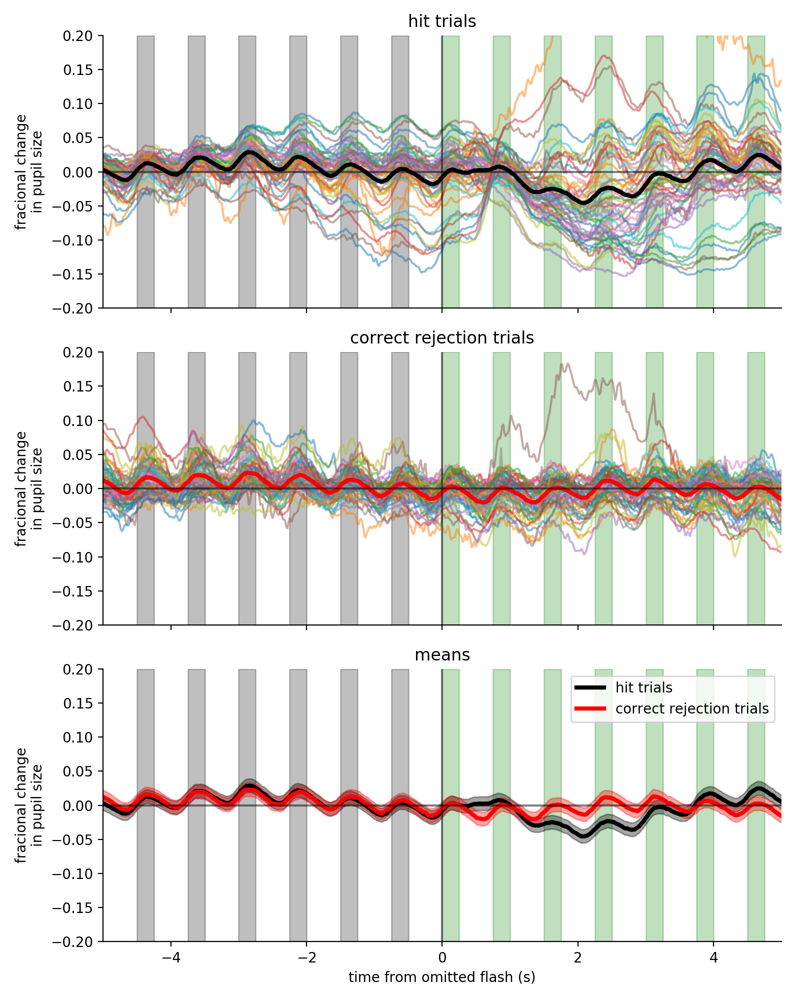

In [16]:
active_sessions = manifest[~(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]

fig,ax=plt.subplots(3,1,figsize=(8,10),sharex=True,sharey=True)
for osid in active_sessions['ophys_session_id'].unique():
    ax[0].plot(df_hit['time'],df_hit[osid],alpha=0.5)
    ax[1].plot(df_cr['time'],df_cr[osid],alpha=0.5)
    
    
for ii in [0,2]:
    ax[ii].plot(df_hit['time'],df_hit[active_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='black')
for ii in [1,2]:
    ax[ii].plot(df_cr['time'],df_cr[active_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='red')

for df,color in zip([df_hit,df_cr],['black','red']):
    cols = active_sessions['ophys_session_id'].unique()
    ax[2].fill_between(
        df['time'], 
        df[cols].mean(axis=1) + 0.01, # + df[cols].std(axis=1)/np.sqrt(len(cols)), 
        df[cols].mean(axis=1) - 0.01, #df[cols].std(axis=1)/np.sqrt(len(cols)), 
        color=color, 
        alpha=0.35
    )
    
ax[0].set_title('hit trials')
ax[1].set_title('correct rejection trials')
ax[2].set_title('means')
ax[2].legend(['hit trials','correct rejection trials'])

ax[0].set_xlim(-5,5)
ax[0].set_ylim(-.2,.2)
for ii in range(3):
    ax[ii].axvline(0,color='black',alpha=0.5)
    ax[ii].axhline(0,color='black',alpha=0.5)
    et.designate_flashes(ax[ii],pre_color='black',post_color='green')
    ax[ii].set_ylabel("fracional change\nin pupil size")
ax[2].set_xlabel('time from omitted flash (s)')

sns.despine()
fig.tight_layout()

In [17]:
active_sessions = manifest[~(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]
active_sessions['ophys_session_id'].unique()

array([952434025, 948090163, 943299247, 941300832, 940446507, 939524851,
       894204946, 893937838, 892217026, 889179793, 888940531, 888190799,
       884359468, 880753403, 878918807, 873542787, 863981645, 860331718,
       855333357, 852326785, 850959798, 850959102, 849600749, 849597937,
       848264483, 848253761, 848143026, 846599329, 845219209, 842583486,
       835796136, 835795999, 833812106, 833002992, 830272668, 825682242,
       824745199, 822388759, 819949602, 812802821, 809393834, 808387448,
       808340530, 808092249, 807393193, 807208045, 806203732, 805643175,
       805269503, 804929369, 803223329, 799195371, 799021448, 794082263,
       789220000, 775289198])

## get mean pupil diameter early in each session

In [18]:
sessions = manifest[(manifest['project_code']=='VisualBehavior')]
early_session_means = []
for _,session in sessions.iterrows():
    osid = session['ophys_session_id']
    df = eye_dict[osid].ellipse_fits['pupil'].rename(columns={'t':'time'})
    
    early_session_means.append({
        'ophys_session_id':osid,
        'first_10_minute_mean':df.query('time > 300 and time < 900')['blink_corrected_area'].mean(),
        'stage_name':et.get_session_name(session['stage_name']),
        'donor_id':session['donor_id'],
    })
early_session_means = pd.DataFrame(early_session_means)

In [19]:
early_session_means

,donor_id,first_10_minute_mean,ophys_session_id,stage_name
0,882757043,4598.533717,961226856,A2
1,875479693,4413.068671,952434025,B3
2,875479693,3378.451760,948090163,A3
3,854625254,7506.523423,943299247,B3
4,854625254,7220.361967,942114744,B2
5,854625254,6886.822167,941300832,B1
6,854625254,5498.407328,940446507,A3
7,875479693,4710.903465,939524851,A1
8,847074139,4676.328308,898295293,B2
9,847076515,6831.166758,894204946,B3


<IPython.core.display.Javascript object>


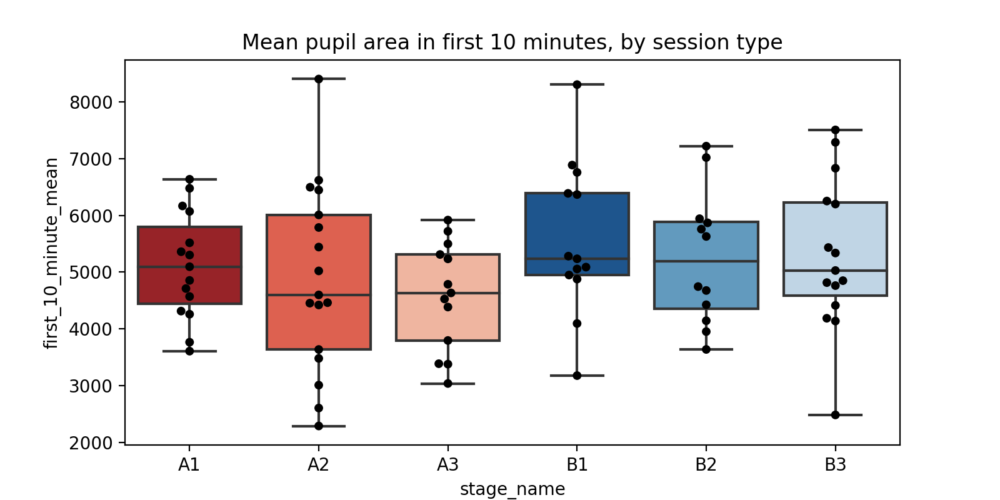

['black', 'black', 'black', 'black', 'black', 'black']
[(0.6663437139561708, 0.06339100346020761, 0.08641291810841982), (0.9570011534025374, 0.3087120338331411, 0.22191464821222606), (0.9882352941176471, 0.6866743560169165, 0.5778854286812765), (0.044059976931949255, 0.3338869665513264, 0.6244521337946944), (0.3262898885044214, 0.6186236063052672, 0.802798923490965), (0.7309496347558632, 0.8394771241830065, 0.9213225682429834)]


Text(0.5, 1.0, 'Mean pupil area in first 10 minutes, by session type')

In [20]:
fig,ax=plt.subplots(figsize=(8,4))

for plot,palette,alpha in zip([sns.swarmplot,sns.boxplot],[['black']*6,et.get_colors_for_session_numbers()],[1,0.5]):
    print(palette)
    plot(
        x='stage_name',
        y='first_10_minute_mean',
        data=early_session_means,
        order = np.sort(early_session_means['stage_name'].unique()),
        ax=ax,
        palette=palette,

    )
ax.set_title('Mean pupil area in first 10 minutes, by session type')

<IPython.core.display.Javascript object>


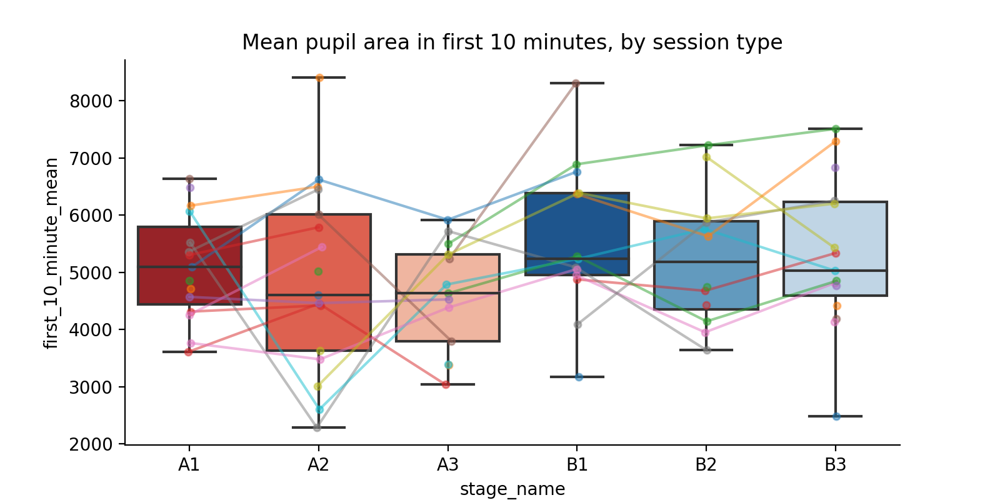

In [21]:
session_names = np.sort(early_session_means['stage_name'].unique())

fig,ax=plt.subplots(figsize=(8,4))
sns.boxplot(
    x='stage_name',
    y='first_10_minute_mean',
    data=early_session_means,
    order = np.sort(early_session_means['stage_name'].unique()),
    ax=ax,
    palette=et.get_colors_for_session_numbers(),
    )
ax.set_title('Mean pupil area in first 10 minutes, by session type')

for donor_id in early_session_means.donor_id.unique():
    df = early_session_means.query('donor_id == @donor_id')
    
    ax.plot(
        np.arange(6)+0.01*np.random.randn(6),
        [df.query('stage_name==@s')['first_10_minute_mean'].iloc[0] if len(df.query('stage_name==@s'))>0 else np.nan for s in session_names],
        marker='o',
        markersize=4,
        alpha=0.5
    )
sns.despine()

## look at an example in time

## look at pupil preceding first flashes and following last

In [22]:
first_stim_df = pd.DataFrame()
last_stim_df = pd.DataFrame()

duration = 10

for osid in behavior_dict.keys():
    ed = eye_dict[osid]
    bd = behavior_dict[osid]
    
    vs = bd.visual_stimuli[bd.visual_stimuli['image_name'].str.startswith('im')]
    first_stim = vs.iloc[0]['time']
    last_stim = vs.iloc[-1]['time']
    
    df = ed.ellipse_fits['pupil']
    if 'time' in df.columns:
        t = 'time'
    else:
        t = 't'
        
    if df.index.name == 't' or df.index.name == 'time':
        pass
    else:
        df.set_index(t,inplace=True)
    
    new_t = np.arange(-duration,duration,1/60.)
    if len(first_stim_df) == 0:
        first_stim_df['time'] = new_t
        last_stim_df['time'] = new_t
        
    first_stim_df[osid] = np.interp(
        new_t, 
        df.loc[first_stim-duration:first_stim+duration].index.values - first_stim, 
        df.loc[first_stim-duration:first_stim+duration]['normalized_blink_corrected_area'].values
    )
    last_stim_df[osid] = np.interp(
        new_t, 
        df.loc[last_stim-duration:last_stim+duration].index.values - last_stim, 
        df.loc[last_stim-duration:last_stim+duration]['normalized_blink_corrected_area'].values
    )
    

In [23]:
df

,center_x,center_y,height,phi,width,area,frame,likely_outlier,likely_blinks,blink_corrected_center_x,blink_corrected_center_y,blink_corrected_height,blink_corrected_phi,blink_corrected_width,blink_corrected_area,blink_corrected_likely_outlier,normalized_blink_corrected_area
time,,,,,,,,,,,,,,,,,
0.51230,295.864185,203.601508,43.092026,0.092459,45.783050,6585.053760,0,False,False,295.864185,203.601508,43.092026,0.092459,45.783050,6585.053760,0.0,0.559117
0.52564,292.682895,205.367668,43.452184,0.066941,46.646805,6835.868185,1,False,False,292.682895,205.367668,43.452184,0.066941,46.646805,6835.868185,0.0,0.580413
0.55437,288.721943,205.874677,42.458452,-0.036699,47.082273,6964.095515,2,False,False,288.721943,205.874677,42.458452,-0.036699,47.082273,6964.095515,0.0,0.591300
0.58778,286.936158,207.235889,41.739078,-0.084883,47.650017,7133.061921,3,False,False,286.936158,207.235889,41.739078,-0.084883,47.650017,7133.061921,0.0,0.605647
0.62132,287.398441,206.748546,42.167743,-0.127312,47.410153,7061.428766,4,False,False,287.398441,206.748546,42.167743,-0.127312,47.410153,7061.428766,0.0,0.599565
0.65444,289.196777,205.698207,42.562600,-0.023277,47.116514,6974.228517,5,False,False,289.196777,205.698207,42.562600,-0.023277,47.116514,6974.228517,0.0,0.592161
0.68777,291.207735,205.896213,42.415173,-0.055012,46.433585,6773.518246,6,False,False,291.207735,205.896213,42.415173,-0.055012,46.433585,6773.518246,0.0,0.575119
0.72118,290.650361,205.435114,43.019356,0.039697,46.281806,6729.309014,7,False,False,290.650361,205.435114,43.019356,0.039697,46.281806,6729.309014,0.0,0.571365
0.75450,290.570374,205.840943,42.579965,0.003055,46.145796,6689.815789,8,False,False,290.570374,205.840943,42.579965,0.003055,46.145796,6689.815789,0.0,0.568012


<IPython.core.display.Javascript object>


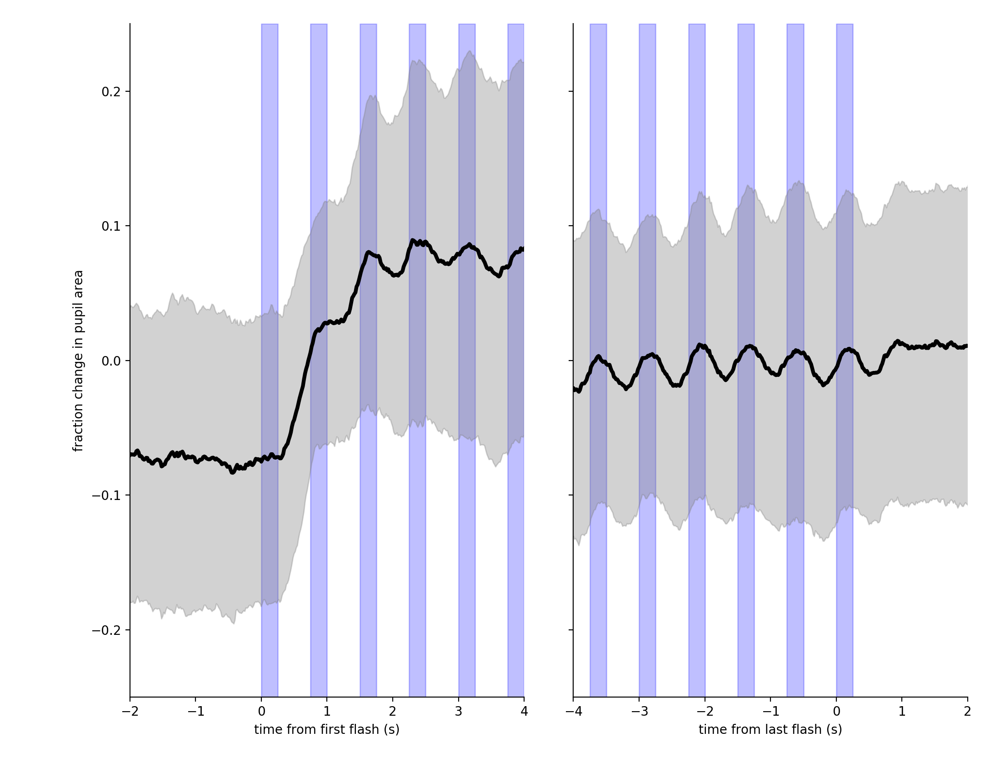

In [24]:
cols = [c for c in first_stim_df.columns if c != 'time']

fig,ax = plt.subplots(1,2,figsize=(6,6),sharey=True)

for ii,df in enumerate([first_stim_df,last_stim_df]):
    et.plot_event_triggered_response(
        df, 
        ax=ax[ii], 
        title='', 
        mean_subtract = False, 
        fraction = True,
        time_zero_subtract = False, 
        fg_color='black',
        bg_color='gray', 
        show_traces=False
    )


et.designate_flashes(ax[0],pre_color='white',post_color='blue')
et.designate_flashes(ax[1],pre_color='blue',post_color='white')
ax[1].axvspan(0,0.25,color='blue',alpha=0.25,zorder=-np.inf)
ax[0].set_xlim(-2,4)
ax[1].set_xlim(-4,2)
for axis in ax:
    axis.set_ylim(-.25,.25)
    
# ax[0].set_title('pupil diameter at beginning of flash sequence')
# ax[1].set_title('pupil diameter at end of flash sequence')
ax[0].set_xlabel('time from first flash (s)')
ax[1].set_xlabel('time from last flash (s)')
ax[0].set_ylabel('fraction change in pupil area')
fig.tight_layout()
sns.despine()

fig_title = 'pupil_oscillations_start_end'
if save_figures:
    vbp.save_figure(fig,os.path.join(figure_savefolder,fig_title),formats=['.pdf','.png'])

## plot pupil for each individual image

In [25]:
osid = 955991376
bd = et.open_behavior_data(osid)
ed = et.open_eye_data(osid)

opening behavior data for osid = 955991376
opening eye data for osid = 955991376


In [26]:
def make_image_response_plot(osid):
    ed = et.open_eye_data(osid)
    bd = et.open_behavior_data(osid)
    pupil_responses,running_responses = et.get_individual_image_responses(ed,bd)
    fig,ax = et.plot_individual_image_responses(pupil_responses,running_responses)
    return fig,ax

opening eye data for osid = 955991376
opening behavior data for osid = 955991376


<IPython.core.display.Javascript object>


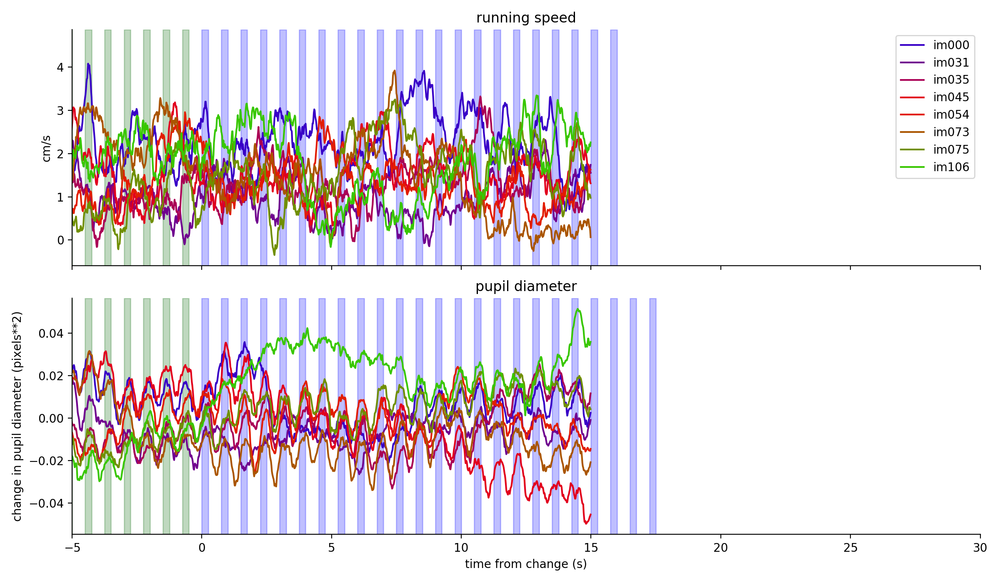

In [27]:
make_image_response_plot(osid);

In [28]:
osid

955991376

In [29]:
ed = et.open_eye_data(osid)
bd = et.open_behavior_data(osid)
pupil_responses,running_responses = et.get_individual_image_responses(ed,bd)
    

opening eye data for osid = 955991376
opening behavior data for osid = 955991376


In [30]:
fig = plot_utils.plotly_event_triggered_response_plot(
    pupil_responses['im000'],
    x_value='time',
    y_values=[c for c in pupil_responses['im000'] if c!='time'],
    var_name='event_number', 
    value_name='pupil_diameter'
)
fig.show()

In [31]:
first_times = bd.visual_stimuli.query('image_name == "im000" and consecutive_flashes == 0')['time']
first_times.iloc[32]

3004.72911

In [32]:
osid

955991376

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.fftpack

def plotFFT(t,y,sampling_rate,ax=None):
   
    if ax is None:
        fig,ax = plt.subplots()
        
    N = np.max(t)*sampling_rate
    yf = scipy.fftpack.fft(y)
    tf = np.linspace(0.0, sampling_rate/(2.0), N/2)
    
    ax.plot(tf, 2.0/N * np.abs(yf[0:int(N/2)]))

In [34]:
# Number of samplepoints

# sample spacing
sampling_rate = 60 #Hz
T_final = 20 #seconds
N = T_final*sampling_rate
t = np.linspace(0.0, T_final, N)

mode1 = 5
mode2 = 20
y = np.sin(mode1*2.0*np.pi*t) + 0.5*np.sin(mode2*2.0*np.pi*t) + np.random.randn(len(t)) + 2

<IPython.core.display.Javascript object>


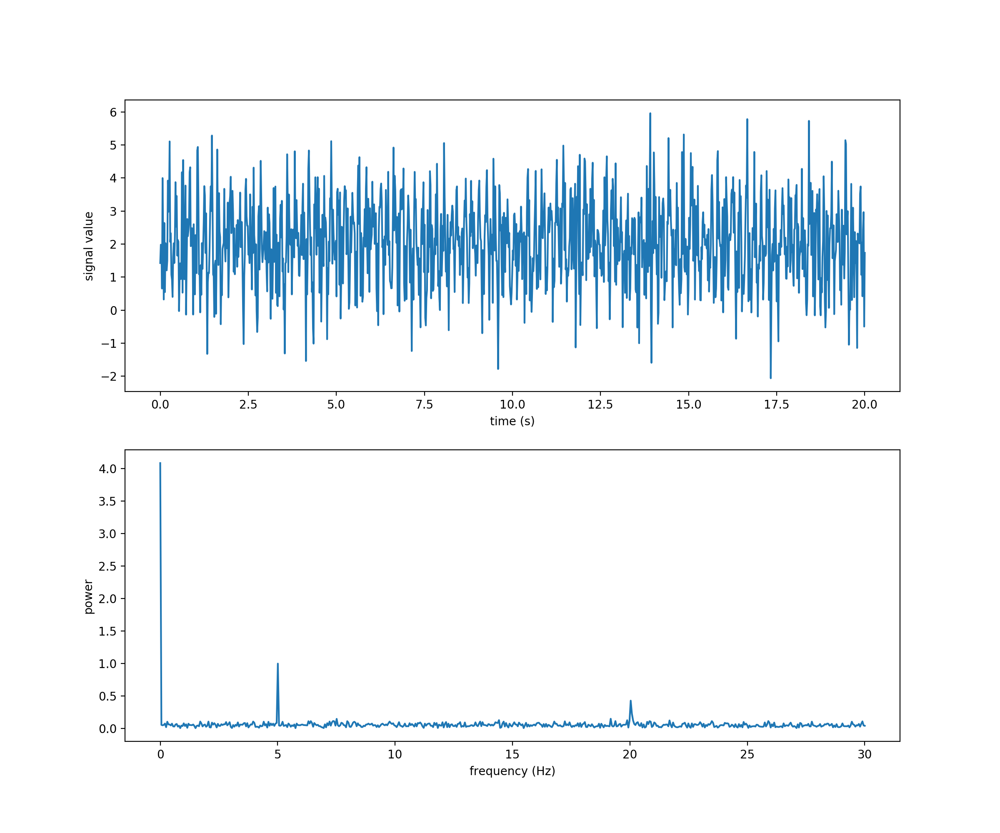

Text(0, 0.5, 'signal value')

In [35]:
fig, ax = plt.subplots(2,1,figsize=(12,10))
ax[0].plot(t,y)
plotFFT(t,y,sampling_rate,ax=ax[1])

ax[1].set_xlabel('frequency (Hz)')
ax[1].set_ylabel('power')

ax[0].set_xlabel('time (s)')
ax[0].set_ylabel('signal value')

<IPython.core.display.Javascript object>


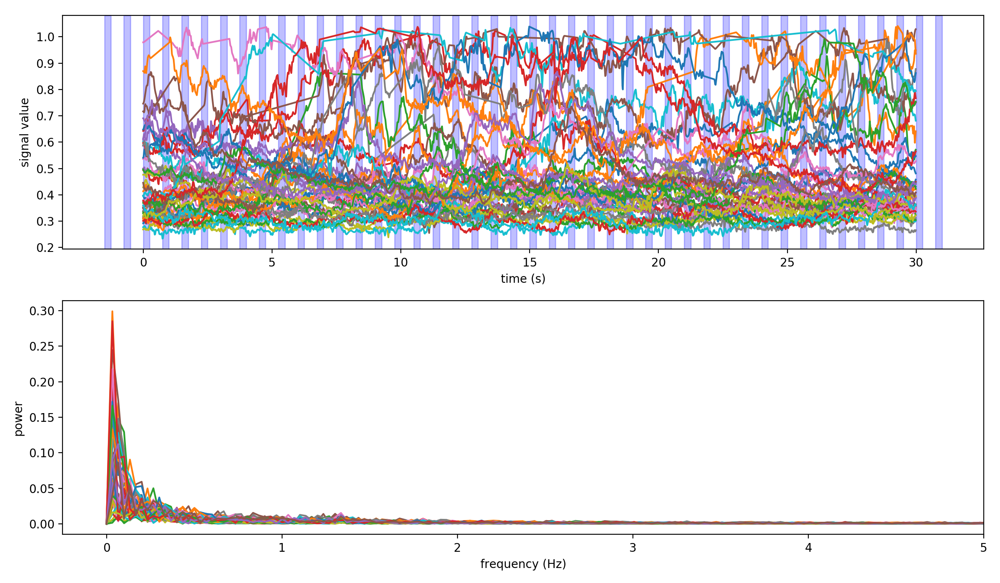

In [36]:
fig, ax = plt.subplots(2,1,figsize=(12,7))

df = pupil_responses['im000']
cols = [c for c in df.columns if c!='time']

t = df['time'].values - df['time'].values.min()

for col in cols:
    
    y = df[col].values

    ax[0].plot(t,y)
    plotFFT(
        t,
        y-np.mean(y),
        sampling_rate=60,
        ax=ax[1]
    )

ax[1].set_xlabel('frequency (Hz)')
ax[1].set_ylabel('power')

et.designate_flashes(ax[0])

ax[0].set_xlabel('time (s)')
ax[0].set_ylabel('signal value')

ax[1].set_xlim(-0.25,5)

fig.tight_layout()

In [37]:
1/1.57

0.6369426751592356

In [38]:
1/1.88

0.5319148936170213

In [39]:
9.2-8.6

0.5999999999999996

In [40]:
12.2 - 11.55

0.6499999999999986

In [41]:
import plotly.express as px


In [42]:
df = pupil_responses['im000']
df

,time,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45
0,-15.000000,0.396966,0.334515,0.354822,0.493717,0.499414,0.310568,0.299811,0.316891,0.428150,0.276837,0.291648,0.309018,0.335353,0.642632,0.609623,0.716546,0.356955,0.374133,0.268283,0.602637,0.350675,0.310653,0.329216,0.301398,0.586067,0.348430,0.536232,0.339743,0.476211,0.359972,0.540684,0.413189,0.369065,0.596637,0.690369,0.445584,0.978894,0.587876,0.320273,0.394614,0.647962,0.869514,0.496048,0.378164,0.613751,0.746126
1,-14.983333,0.395180,0.334515,0.354822,0.493717,0.500073,0.310568,0.302526,0.316723,0.428150,0.276837,0.291648,0.309157,0.333398,0.642632,0.615046,0.715253,0.356955,0.374133,0.269370,0.602637,0.348263,0.310653,0.326341,0.301398,0.593693,0.349641,0.536232,0.339743,0.476211,0.359972,0.543375,0.413541,0.368788,0.596380,0.689394,0.437544,0.978894,0.588207,0.323237,0.394614,0.650437,0.869514,0.492802,0.377929,0.620377,0.749139
2,-14.966667,0.389065,0.332632,0.355733,0.494316,0.503594,0.310652,0.309437,0.316409,0.434729,0.278516,0.297316,0.312337,0.331113,0.650984,0.623349,0.712819,0.359057,0.372029,0.271945,0.598975,0.341569,0.310001,0.323027,0.301717,0.604644,0.354060,0.537935,0.339409,0.476506,0.355823,0.559826,0.417163,0.367617,0.594221,0.684327,0.425179,0.980005,0.596002,0.327016,0.399931,0.656120,0.866553,0.488495,0.371600,0.630549,0.754286
3,-14.950000,0.385167,0.330449,0.357940,0.497061,0.504123,0.311452,0.310900,0.314897,0.442175,0.281457,0.303902,0.315062,0.333881,0.660220,0.622716,0.718187,0.366568,0.364920,0.272633,0.594449,0.339777,0.308817,0.321146,0.304648,0.607479,0.357155,0.541545,0.337642,0.477539,0.345090,0.572790,0.420962,0.367216,0.591363,0.680048,0.422506,0.981205,0.603798,0.328417,0.406990,0.660743,0.863106,0.485956,0.365549,0.630572,0.762320
4,-14.933333,0.386501,0.338026,0.362193,0.495848,0.492061,0.311273,0.303445,0.312429,0.448939,0.280991,0.300823,0.306916,0.337506,0.661599,0.617319,0.737792,0.373424,0.359124,0.270804,0.595394,0.346476,0.309932,0.319472,0.306436,0.606521,0.356711,0.541642,0.336055,0.477457,0.339622,0.567956,0.426214,0.369507,0.583233,0.678931,0.425127,0.982540,0.599778,0.329166,0.408503,0.664022,0.874255,0.483985,0.365952,0.627921,0.772547
5,-14.916667,0.387599,0.347190,0.372048,0.487407,0.481360,0.301985,0.302398,0.313329,0.455617,0.277916,0.296220,0.299311,0.340580,0.662139,0.633952,0.744174,0.378671,0.356375,0.268976,0.597720,0.346422,0.312923,0.317983,0.299381,0.609492,0.357472,0.537800,0.335279,0.474636,0.342503,0.562264,0.431371,0.371481,0.575434,0.678188,0.422007,0.983909,0.594061,0.322347,0.408247,0.665451,0.887835,0.484808,0.366491,0.635108,0.784153
6,-14.900000,0.388153,0.347149,0.376263,0.482456,0.476515,0.295018,0.319992,0.316939,0.456500,0.274592,0.293064,0.304989,0.343559,0.674288,0.662106,0.738659,0.382164,0.355520,0.267148,0.598394,0.334560,0.313343,0.316523,0.292325,0.614100,0.361485,0.534779,0.334860,0.471539,0.343667,0.552295,0.435703,0.372390,0.570662,0.678968,0.415704,0.985195,0.580728,0.313505,0.406046,0.662327,0.877084,0.486527,0.369656,0.644763,0.796757
7,-14.883333,0.387530,0.345502,0.372150,0.484116,0.474570,0.308625,0.324286,0.313517,0.456616,0.271083,0.290146,0.310354,0.340489,0.687659,0.671070,0.736549,0.375725,0.359264,0.266275,0.598154,0.326010,0.311750,0.320909,0.304069,0.612263,0.365481,0.532667,0.336027,0.467768,0.342202,0.545344,0.438555,0.373714,0.565320,0.679560,0.414525,0.986474,0.567547,0.311310,0.403233,0.659796,0.862126,0.488234,0.372433,0.663088,0.806145
8,-14.866667,0.384146,0.349012,0.370171,0.487407,0.486239,0.320506,0.306048,0.304561,0.451624,0.268631,0.299310,0.304341,0.336406,0.689136,0.670272,0.737427,0.374265,0.360156,0.268327,0.588659,0.327993,0.310033,0.326092,0.315133,0.607639,0.369163,0.532901,0.336256,0.466823,0.338651,0.552796,0.429085,0.376362,0.555691,0.677011,0.416087,0.987758,0.557651,0.310837,0.400857,0.658039,0.874953,0.489937,0.368470,0.683667,0.813056
9,-14.850000,0.382059,0